In [ ]:
import cv2
import mediapipe as mp
import time
import os

cap = cv2.VideoCapture("part_2_of_2/10/low.MP4")

mp_facedetector = mp.solutions.face_detection
mp_draw = mp.solutions.drawing_utils

# Create a folder to store the detected faces
output_folder = "detected_faces"
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with mp_facedetector.FaceDetection(min_detection_confidence=0.7) as face_detection:
    face_id = 0  # To name each saved face image
    
    while cap.isOpened():
        success, image = cap.read()
        
        if not success:
            break
        
        start = time.time()
        
        # Convert the BGR image to RGB 
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image and find faces
        results = face_detection.process(image_rgb)
        
        # Convert the image color back so it can be displayed
        image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)
        
        if results.detections:
            for id, detection in enumerate(results.detections):
                mp_draw.draw_detection(image_bgr, detection)
                print(id, detection)
                
                # Get bounding box dimensions
                bBox = detection.location_data.relative_bounding_box
                h, w, c = image_bgr.shape
                
                boundBox = int(bBox.xmin * w), int(bBox.ymin * h), int(bBox.width * w), int(bBox.height * h)
                
                # Crop and save the detected face
                x, y, width, height = boundBox
                cropped_face = image_bgr[y:y+height, x:x+width]
                
                # Save the cropped face image in the folder
                face_file_path = os.path.join(output_folder, f"face_{face_id}.jpg")
                cv2.imwrite(face_file_path, cropped_face)
                face_id += 1  # Increment for the next face
                
                # Display detection score on image
                cv2.putText(image_bgr, f"{int(detection.score[0] * 100)}%", (boundBox[0], boundBox[1] - 20), 
                            cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)
                
        end = time.time()
        total_time = end - start
        
        fps = 1 / total_time
        print("FPS: ", fps)
        cv2.putText(image_bgr, f'FPS: {int(fps)}', (20, 70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)
        
        cv2.imshow("Face Detection", image_bgr)
        
        if cv2.waitKey(5) & 0xFF == 27:
            break

cap.release()
cv2.destroyAllWindows()


In [ ]:
import cv2
import mediapipe as mp
import time
import os

# Function to detect blurriness using the variance of the Laplacian
def variance_of_laplacian(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

# Set threshold for blur detection (experiment with this value)
blur_threshold = 100  # Adjust based on your requirement

# Create folders for detected faces and blurry faces
output_folder = "detected_faces"
blur_folder = "blur_faces"
if not os.path.exists(output_folder):
    os.makedirs(output_folder)
if not os.path.exists(blur_folder):
    os.makedirs(blur_folder)

# Initialize MediaPipe face detector
mp_facedetector = mp.solutions.face_detection
mp_draw = mp.solutions.drawing_utils

cap = cv2.VideoCapture("part_2_of_2/10/low.MP4")

with mp_facedetector.FaceDetection(min_detection_confidence=0.7) as face_detection:
    face_id = 0  # To name each saved face image
    
    while cap.isOpened():
        success, image = cap.read()
        
        if not success:
            break
        
        start = time.time()
        
        # Convert the BGR image to RGB 
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image and find faces
        results = face_detection.process(image_rgb)
        
        # Convert the image color back so it can be displayed
        image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)
        
        if results.detections:
            for id, detection in enumerate(results.detections):
                mp_draw.draw_detection(image_bgr, detection)
                print(id, detection)
                
                # Get bounding box dimensions
                bBox = detection.location_data.relative_bounding_box
                h, w, c = image_bgr.shape
                
                boundBox = int(bBox.xmin * w), int(bBox.ymin * h), int(bBox.width * w), int(bBox.height * h)
                
                # Crop and save the detected face
                x, y, width, height = boundBox
                cropped_face = image_bgr[y:y+height, x:x+width]
                
                # Perform blur detection on the cropped face
                blur_measure = variance_of_laplacian(cropped_face)
                
                if blur_measure < blur_threshold:
                    # Save in the blur_faces folder
                    face_file_path = os.path.join(blur_folder, f"blur_face_{face_id}.jpg")
                    print(f"Face {face_id} is blurry with variance: {blur_measure}")
                else:
                    # Save in the detected_faces folder
                    face_file_path = os.path.join(output_folder, f"face_{face_id}.jpg")
                    print(f"Face {face_id} is not blurry with variance: {blur_measure}")
                
                cv2.imwrite(face_file_path, cropped_face)
                face_id += 1  # Increment for the next face
                
                # Display detection score on image
                cv2.putText(image_bgr, f"{int(detection.score[0] * 100)}%", (boundBox[0], boundBox[1] - 20), 
                            cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)
                
        end = time.time()
        total_time = end - start
        
        fps = 1 / total_time
        print("FPS: ", fps)
        cv2.putText(image_bgr, f'FPS: {int(fps)}', (20, 70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)
        
        cv2.imshow("Face Detection", image_bgr)
        
        if cv2.waitKey(5) & 0xFF == 27:
            break

cap.release()
cv2.destroyAllWindows()


In [35]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [36]:
import os
import requests
import base64
import cv2
import torch
from torchvision import models, transforms
from PIL import Image
from gfpgan.utils import GFPGANer
from realesrgan.utils import RealESRGANer
from basicsr.archs.srvgg_arch import SRVGGNetCompact
from IPython.display import display
import os
import requests
from diffusers import DiffusionPipeline, StableDiffusionXLImg2ImgPipeline 
from torchvision.transforms import ToTensor, Normalize, ConvertImageDtype


In [37]:
# URLs for the different model weights
model_urls = {
    # This dictionary contains URLs from which the model weights can be downloaded.
    # Each key is a model file name and the corresponding value is the download URL.
    'realesr-general-x4v3.pth': "https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.5.0/realesr-general-x4v3.pth",
    'GFPGANv1.4.pth': "https://github.com/TencentARC/GFPGAN/releases/download/v1.3.0/GFPGANv1.4.pth",
    #'RestoreFormer.pth': "https://github.com/TencentARC/GFPGAN/releases/download/v1.3.4/RestoreFormer.pth",
    #'CodeFormer.pth': "https://github.com/TencentARC/GFPGAN/releases/download/v1.3.4/CodeFormer.pth",
}

# Create a directory for the weights if it doesn't exist
os.makedirs('weights', exist_ok=True)

# This function downloads a file from a given URL and saves it with the specified filename.
# It streams the content, writing it in chunks to handle large files without consuming too much memory.
# It also prints out the status of the download.
def download_file(url, filename):
    response = requests.get(url, stream=True)
    if response.status_code == 200:
        with open(filename, 'wb') as f:
            for chunk in response.iter_content(chunk_size=1024):
                f.write(chunk)
        print(f"Downloaded {filename}")
    else:
        print(f"Failed to download {filename}. Status code: {response.status_code}")

# This loop goes through the dictionary of model URLs, checks if the file already exists locally,
# and if not, it uses the 'download_file' function to download and save the weights.
for filename, url in model_urls.items():
    file_path = os.path.join('weights', filename)
    if not os.path.exists(file_path):
        print(f"Downloading {filename}...")
        download_file(url, file_path)
    else:
        print(f"{filename} already exists. Skipping download.")

realesr-general-x4v3.pth already exists. Skipping download.
GFPGANv1.4.pth already exists. Skipping download.


In [38]:
# This line of code prints the list of files in the 'weights' directory.
# It's used to verify that the required model weights have been downloaded successfully.
print(os.listdir('weights'))


['GFPGANv1.4.pth', 'realesr-general-x4v3.pth']


In [39]:
# # Load RealESRGAN model
# realesrgan_model_path = 'weights/realesr-general-x4v3.pth'

# # Initialize RealESRGAN
# sr_model = SRVGGNetCompact(num_in_ch=3, num_out_ch=3, num_feat=64, num_conv=32, upscale=4, act_type='prelu')
# half = True if torch.cuda.is_available() else False
# print(half)

# realesrganer = RealESRGANer(scale=4, model_path=realesrgan_model_path, model=sr_model, tile=0, tile_pad=10, pre_pad=0, half=half)
# # Load the RealESRGAN model safely

# # Function to upscale image with RealESRGAN
# def upscale_image(image_path, output_path):
#     img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
#     # Upscale the image with RealESRGAN
#     output, _ = realesrganer.enhance(img, outscale=4)
#     cv2.imwrite(output_path, output)
#     return output


# Load RealESRGAN model
realesrgan_model_path = 'weights/realesr-general-x4v3.pth'

# Initialize RealESRGAN
sr_model = SRVGGNetCompact(num_in_ch=3, num_out_ch=3, num_feat=64, num_conv=32, upscale=4, act_type='prelu')

# Check if CUDA is available and set device accordingly
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
half = device.type == 'cuda'
print(f"Running on {'GPU' if half else 'CPU'}")

# Move model to GPU if available
sr_model = sr_model.to(device)

# Initialize the RealESRGANer with the model loaded on GPU
realesrganer = RealESRGANer(
    scale=4, 
    model_path=realesrgan_model_path, 
    model=sr_model, 
    tile=0, 
    tile_pad=10, 
    pre_pad=0, 
    half=half
)

# Function to upscale image with RealESRGAN
def upscale_image(image_path, output_path):
    # Read image
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    
    # Convert image to tensor and move it to GPU if available
    img_tensor = torch.from_numpy(img).float().permute(2, 0, 1).unsqueeze(0).to(device)
    
    # Upscale the image with RealESRGAN
    output, _ = realesrganer.enhance(img_tensor, outscale=4)
    
    # Move the output back to CPU and save as image
    output = output.squeeze(0).permute(1, 2, 0).cpu().numpy()
    
    # Write the upscaled image
    cv2.imwrite(output_path, output)
    return output

# Example usage:
# upscale_image('input_image.png', 'output_image.png')


Running on GPU


c:\Users\Mayank Bhushan\.conda\envs\env1\Lib\site-packages\realesrgan\utils.py:63: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  loadnet = torch.load(model_path, map_locatio

In [40]:
# Load GFPGAN model
gfpgan_model_path = 'weights/GFPGANv1.4.pth'

# Initialize GFPGAN
face_enhancer = GFPGANer(model_path=gfpgan_model_path, upscale=10, arch='clean', channel_multiplier=2, bg_upsampler=realesrganer)

# Function to enhance image with GFPGAN
def enhance_faces(image_path, output_path):
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    # Enhance faces with GFPGAN
    _, _, img_enhanced = face_enhancer.enhance(img, has_aligned=False, only_center_face=False, paste_back=True)
    cv2.imwrite(output_path, img_enhanced)
    return img_enhanced

c:\Users\Mayank Bhushan\.conda\envs\env1\Lib\site-packages\facexlib\detection\__init__.py:22: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  load_net = torch.load(model_path,

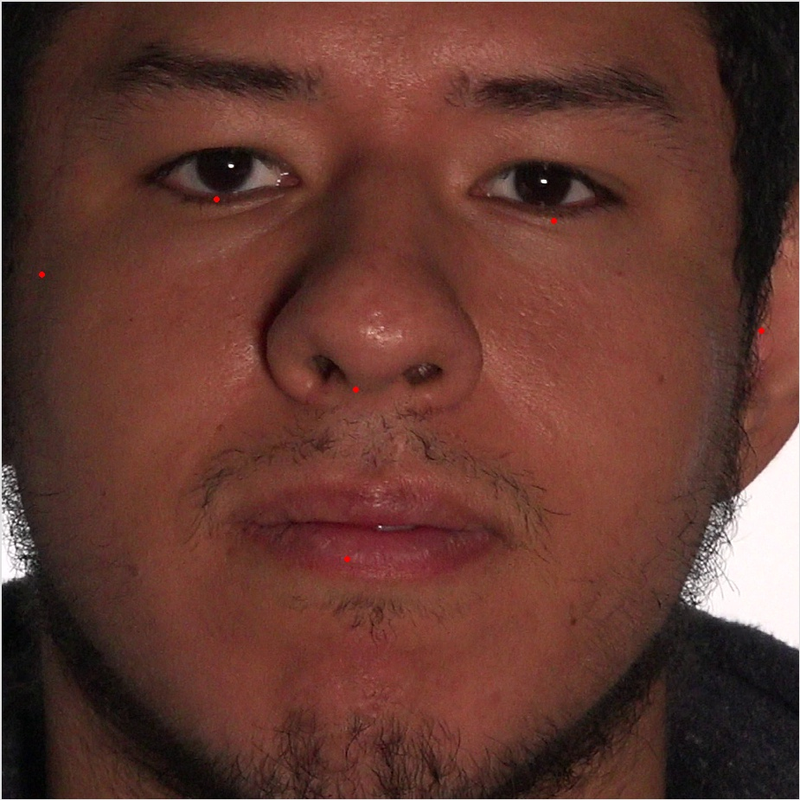

In [41]:
initial_image_path = 'detected_faces/face_518.jpg'
# Load the image with PIL
photo = Image.open(initial_image_path)
# Display the image with a specific max width and height
display(photo.resize((800, 800), Image.LANCZOS))

In [42]:
# Enhance faces in the image
# Calls a function to enhance faces in the refined image using GFPGAN.
# Saves the image with enhanced faces locally and displays it within the notebook.
# Handles exceptions during the face enhancement process.

# Define the path for the enhanced faces image
enhanced_faces_path = "enhance/enhanced_faces.jpg"

try:
    # applies face enhancement, and saves the result to a new file
    enhance_faces(initial_image_path, enhanced_faces_path)

    # Display the image with enhanced faces
    # Open the enhanced image from the saved path
    enhanced_image_to_display = Image.open(enhanced_faces_path)
    display(enhanced_image_to_display)

except Exception as err:
    print(f"An error occurred during face enhancement: {err}")

In [43]:
import os
from PIL import Image

# Define the folder paths
blur_folder = "blur1"
enhanced_folder = "enhance"

# Create the enhanced folder if it doesn't exist
if not os.path.exists(enhanced_folder):
    os.makedirs(enhanced_folder)

# Function to enhance faces (this assumes the function enhance_faces is already defined)


# Get all image files from the blur folder
blur_images = [f for f in os.listdir(blur_folder) if f.endswith('.jpg') or f.endswith('.png')]

# Process each image in the blur folder
for img_name in blur_images:
    # Define the input and output paths
    initial_image_path = os.path.join(blur_folder, img_name)
    enhanced_image_path = os.path.join(enhanced_folder, f"enhanced_{img_name}")
    
    try:
        # Enhance the face in the image and save the enhanced result
        enhance_faces(initial_image_path, enhanced_image_path)
        
        print(f"Enhanced image saved: {enhanced_image_path}")
    
    except Exception as err:
        print(f"An error occurred during face enhancement for {img_name}: {err}")


Enhanced image saved: enhance\enhanced_face_516.jpg
Enhanced image saved: enhance\enhanced_face_517.jpg
Enhanced image saved: enhance\enhanced_face_518.jpg
Enhanced image saved: enhance\enhanced_face_519.jpg
Enhanced image saved: enhance\enhanced_face_520.jpg
Enhanced image saved: enhance\enhanced_face_521.jpg
Enhanced image saved: enhance\enhanced_face_522.jpg
Enhanced image saved: enhance\enhanced_face_523.jpg
Enhanced image saved: enhance\enhanced_face_524.jpg
